In [1]:
%env PYTHONHASHSEED=0

env: PYTHONHASHSEED=0


In [2]:
import numpy as np
import pandas as pd
import os

import scanpy as sc
from anndata import AnnData, concat
from matplotlib.transforms import Bbox

# from scvi.model.utils import mde

import scvi 
from matplotlib import pyplot as plt
import seaborn as sns

from scipy import sparse
import gc
# from upsetplot import plot as UpSet
from itertools import product
import networkx as nx

from scipy.cluster import hierarchy

import re
import subprocess

import h5py

import itertools

# from scnym.api import scnym_api

# import pymn

from collections import Counter

In [107]:
from scvi.model.utils import mde


In [3]:
out_dir = "/home/anna/ClusterProjects/SA_bone_marrow/scfiles/"

In [4]:
# import tensorflow as tf
# import tensorboard as tb
# tf.io.gfile = tb.compat.tensorflow_stub.io.gfile

pd.set_option('display.max_columns', 500)

In [6]:
### Directory TM_combined_datasets_SA_ann_obs
# combined_datasets = sc.read_h5ad(filename = "../data/h5ad/TM_combined_datasets_SA_ann.h5ad")
# obs_plk = pd.read_pickle("../data/h5ad/TM_combined_datasets_SA_ann_obs.plk")
# combined_datasets.obs = obs_plk

In [88]:
hvg = sc.read("../data/h5ad/hvg_integrated_170824.h5ad")

In [91]:
hvg.obsm

AxisArrays with keys: X_mde, X_pca, X_scVI, X_tsne, X_umap, _scvi_extra_categorical_covs, _scvi_extra_continuous_covs, counts_pca, scVI_norm_pca

### Extracting only SA experiment from the scNym datasets

In [7]:
# SA_exps = combined_datasets[combined_datasets.obs["study_id"].isin(['SA_pilot', 'SA_final'])]

### Saving SA experiment data

In [8]:
# SA_exps.obs.to_pickle(out_dir + "SA_exp_scNym_annotated.plk")
# SA_exps.obs = SA_exps.obs[["study_id", "cell_ontology_class"]]
# SA_exps.write(filename = out_dir + "SA_exp_scNym_annotated.h5ad")

### Reading SA experiment

In [9]:
SA_exps = sc.read_h5ad(filename = out_dir + "SA_exp_scNym_annotated.h5ad")
obs_plk = pd.read_pickle(out_dir + "SA_exp_scNym_annotated.plk")
SA_exps.obs = obs_plk

In [12]:
hvg_cells = hvg.obs_names
SA_exp_names = SA_exps.obs_names

SA_hvg_cells = [x for x in SA_exp_names if x[:-2] in hvg_cells]

SA_cellname_counts = Counter([x[:-2] for x in SA_hvg_cells])
SA_unique_names = [x for x in SA_hvg_cells if SA_cellname_counts[x[:-2]] == 1]

SA_exps_subset = SA_exps[SA_unique_names]

SA_exps_subset.obs_names = [x[:-2] for x in SA_exps_subset.obs_names]

hvg_subset = hvg[SA_exps_subset.obs_names]

hvg_subset.obs["scNym_condensed"] = SA_exps_subset.obs["scNym_condensed"]
hvg_subset.obs["scNym_condensed_confidence"] = SA_exps_subset.obs["scNym_condensed_confidence"]

/tmp/ipykernel_301968/2522876148.py:15: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  hvg_subset.obs["scNym_condensed"] = SA_exps_subset.obs["scNym_condensed"]


In [13]:
SA_exps_HSC = SA_exps_subset[SA_exps_subset.obs["scNym_condensed"] == "hematopoietic precursor cell"]
SA_exps_mature = SA_exps_subset[SA_exps_subset.obs["scNym_condensed"] != "hematopoietic precursor cell"]

### HSC population

In [92]:
hvg_HSC_v2 = hvg_subset[SA_exps_HSC.obs_names.intersection(hvg_subset.obs_names)]
# SA_HSC_v2 = SA_exps_HSC[SA_exps_HSC.obs_names.intersection(hvg_subset.obs_names)]

In [15]:
hvg_HSC_v2.shape

(2129, 2506)

In [87]:
hvg_HSC_v2.layers

LayersView with keys: counts, scVI_normalized

### Loading the TM HSC SA annotated dataset

In [5]:
combined_HSC = sc.read_loom(filename = "../data/loom/TM_combined_HSC_SA_ann.loom")

/home/anna/miniconda3/envs/scvi-env/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/anna/miniconda3/envs/scvi-env/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [53]:
annotated_SA_HSC = combined_HSC[ combined_HSC.obs["study_id"].isin(["SA_final", "SA_pilot"])]
annotated_SA_HSC.obs_names = annotated_SA_HSC.obs["obs_names"]

In [62]:
del(combined_HSC)

In [54]:
ann_counts = Counter([x[:-4] for x in annotated_SA_HSC.obs_names])
unique_names = [x for x in annotated_SA_HSC.obs_names if ann_counts[x[:-4]] == 1]
annotated_SA_HSC = annotated_SA_HSC[unique_names]
annotated_SA_HSC.obs_names = [x[:-4] for x in annotated_SA_HSC.obs_names]
common_cells = annotated_SA_HSC.obs_names.intersection(hvg_HSC_v2.obs_names)

In [84]:
Counter(hvg_HSC_v2.obs["scNym_HPC"])

Counter({'STHSC': 868,
         'MPP4': 696,
         'MPP3': 535,
         'LTHSC': 22,
         'MPP2': 7,
         'Unknown': 1})

In [104]:
hvg_HSC_v2.obs["scNym_HPC"] = annotated_SA_HSC[common_cells].obs["scNym_HPC"]

In [78]:
sum(common_cells == hvg_HSC_v2.obs_names)

2129

In [13]:
# sc.pp.normalize_total(hvg_HSC_v2, target_sum=1e6)
# sc.pp.log1p(hvg_HSC_v2)

/home/anna/miniconda3/envs/scvi-env/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [63]:
hvg_HSC_v2.shape

(2129, 2506)

In [64]:
hvg_HSC_v2.layers

LayersView with keys: counts, scVI_normalized

In [100]:
hvg_HSC_v2.obsm["X_scVI"]

array([[-0.5186288 , -0.7761467 ,  0.00842507, ..., -0.5243473 ,
         0.03333382, -0.03865403],
       [ 0.45361075,  0.45997787,  0.01205517, ...,  0.1605351 ,
         0.01721191,  0.02108004],
       [-1.3858471 , -0.8272739 , -0.05540706, ..., -0.6123635 ,
         0.01011659, -0.01105339],
       ...,
       [-1.6956205 ,  0.2053634 ,  0.02829646, ...,  0.6750779 ,
         0.01154765, -0.03247486],
       [ 0.21701166,  0.13608909,  0.00652756, ..., -0.89296794,
         0.00357543, -0.04450046],
       [-0.61677635, -0.9025922 ,  0.01408629, ...,  0.01892281,
         0.0534844 , -0.0293964 ]], dtype=float32)

In [85]:
hvg_HSC_v2.layers

Layers with keys: counts, scVI_normalized

In [117]:
sc.tl.pca(hvg_HSC_v2, svd_solver='arpack', layer = "scVI_normalized")
sc.pp.neighbors(hvg_HSC_v2, n_neighbors=10, n_pcs=40, use_rep = "X_pca")
sc.tl.umap(hvg_HSC_v2, random_state=4567898)
sc.tl.leiden(hvg_HSC_v2, resolution=0.25, 
             n_iterations=100)

In [68]:
hvg_HSC_v2.obs

,nCount_RNA,nFeature_RNA,sample,nCount_HTO,nFeature_HTO,HTO_maxID,HTO_secondID,HTO_margin,HTO_classification,hash.ID,RNA_snn_res.0.6,seurat_clusters,percent_mt,nCount_SCT,nFeature_SCT,SCT_snn_res.0.8,rnaseq_labels,immgen_labels,batch,_scvi_batch,_scvi_labels,leiden,scNym_condensed,scNym_condensed_confidence
AAACGAACACAATGCT-1,10813.0,3392,HTO-SA3,218.0,3,HTO-SA3,HTO-SA4,2.225799,HTO-SA3,HTO-SA3,1,5,2.561731,4739.0,2569,5,Monocytes,Stem cells,final,1,0,1,hematopoietic precursor cell,0.997313
AAAGTGAAGAAACTGT-1,4090.0,1801,HTO-SA3,146.0,4,HTO-SA3,HTO-SA4,2.219410,HTO-SA3,HTO-SA3,1,8,4.180929,4184.0,1801,8,Erythrocytes,Stem cells,final,1,0,6,hematopoietic precursor cell,0.765460
AACAACCCAGAGAATT-1,17524.0,4136,HTO-SA4,265.0,4,HTO-SA4,HTO-SA3,3.144304,HTO-SA4,HTO-SA4,0,3,3.218443,4050.0,1956,3,Monocytes,Stem cells,final,1,0,0,hematopoietic precursor cell,0.815809
AACAACCCAGATCCAT-1,7542.0,2820,HTO-PBS3,361.0,3,HTO-PBS3,HTO-PBS4,2.690055,HTO-PBS3,HTO-PBS3,1,5,3.911429,4884.0,2681,5,Monocytes,Stem cells,final,1,0,3,hematopoietic precursor cell,0.966413
AACACACCATAGTCGT-1,21255.0,4486,HTO-SA3,413.0,4,HTO-SA3,HTO-SA4,2.917560,HTO-SA3,HTO-SA3,0,1,2.239473,4080.0,2082,1,Monocytes,Stem cells,final,1,0,2,hematopoietic precursor cell,0.970967
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGATCCATTACGGT-1,12352.0,3422,HTO-SA1,736.0,3,HTO-SA1,HTO-PBS2,2.871989,HTO-SA1,HTO-SA1,2,3,2.307319,2255.0,1269,3,Monocytes,Stem cells,pilot,0,0,0,hematopoietic precursor cell,0.974402
TTTGGAGCACTCCACT-1,3647.0,1613,HTO-SA1,219.0,3,HTO-SA1,HTO-PBS2,1.742563,HTO-SA1,HTO-SA1,1,0,2.029065,2651.0,1582,0,Monocytes,Stem cells,pilot,0,0,1,hematopoietic precursor cell,0.894961
TTTGGTTCAATCAAGA-1,2199.0,1052,HTO-PBS1,523.0,1,HTO-PBS1,HTO-PBS2,3.160230,HTO-PBS1,HTO-PBS1,0,5,2.501137,2196.0,1049,5,Monocytes,Stem cells,pilot,0,0,1,hematopoietic precursor cell,0.533434
TTTGGTTCAGGTGTGA-1,3363.0,1269,HTO-PBS2,511.0,3,HTO-PBS2,HTO-PBS1,3.916576,HTO-PBS2,HTO-PBS2,9,10,3.003271,2569.0,1262,10,B cells,B cells,pilot,0,0,3,hematopoietic precursor cell,0.609765


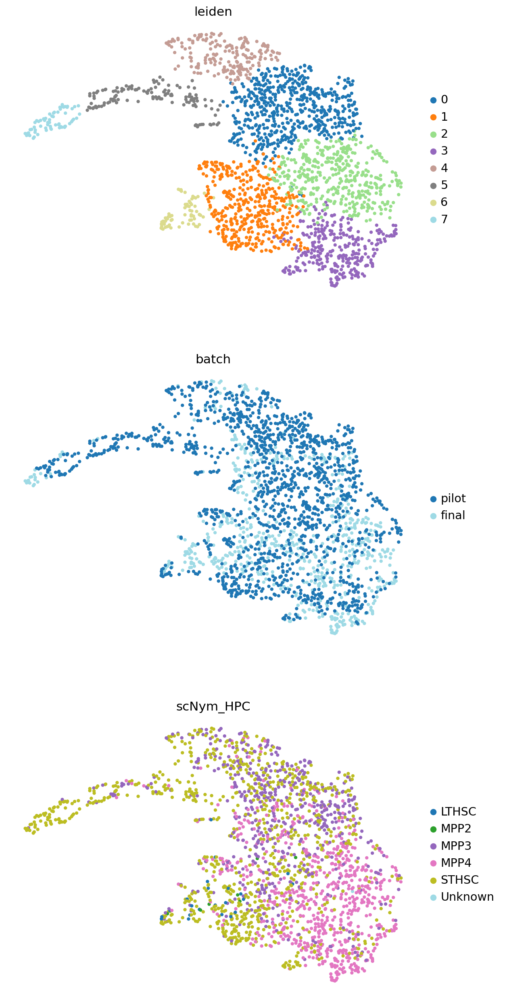

In [120]:
sc.set_figure_params(figsize = (8,6))
sc.pl.embedding(
    hvg_HSC_v2,
    basis="umap",
    # color=['Mariem_annotation'],
    color=['leiden', 'batch', "scNym_HPC"],
    frameon=False,
    ncols=1,
    palette = "tab20",
    save = "hvg_scVI_HSC_v2_leiden_batch_scNym_HPC.pdf"
)

In [108]:
hvg_HSC_v2.obsm["X_mde"] = mde(hvg_HSC_v2.obsm["X_scVI"])

INFO     Using cpu for `pymde.preserve_neighbors`.                                                                 


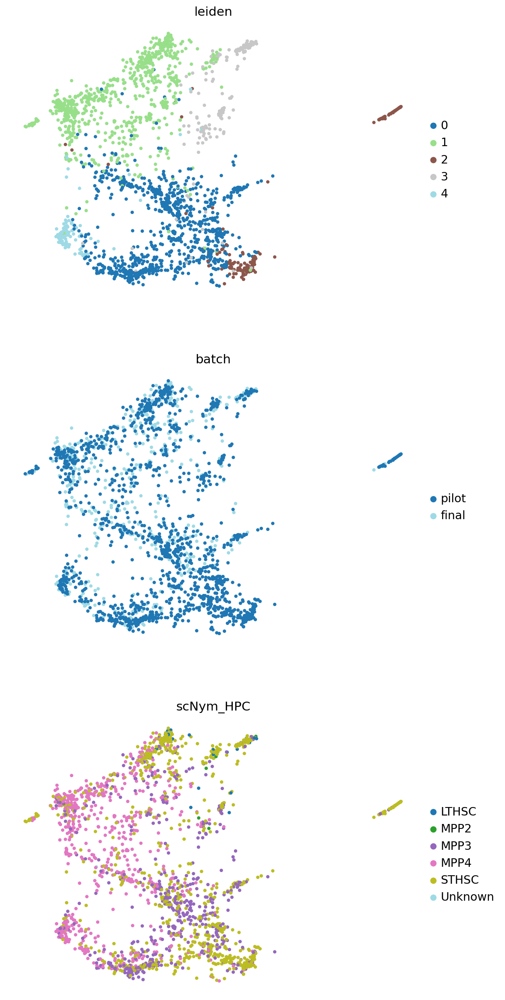

In [111]:
sc.pl.embedding(
    hvg_HSC_v2,
    basis="X_mde",
    color=['leiden', 'batch', "scNym_HPC"],
    frameon=False,
    ncols=1,
)

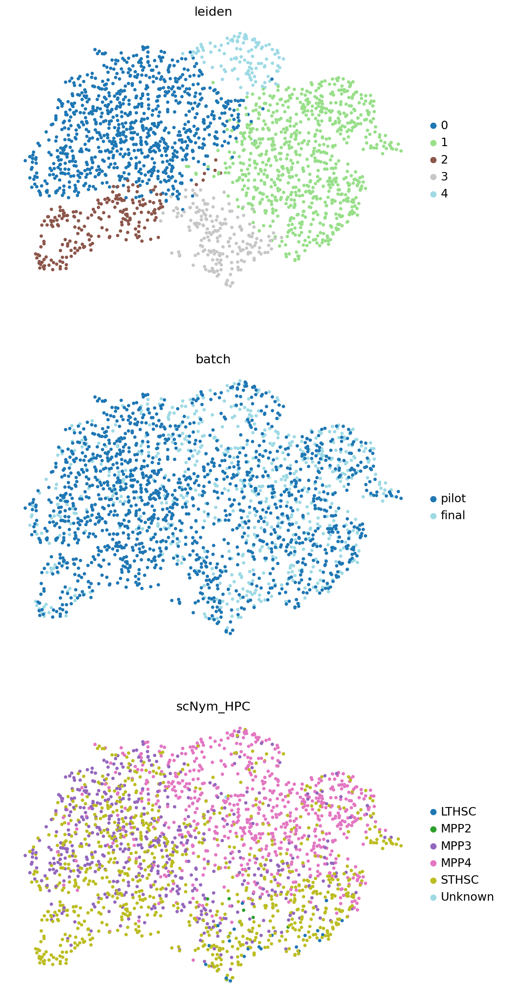

In [109]:
sc.set_figure_params(figsize = (8,6))
sc.pl.embedding(
    hvg_HSC_v2,
    basis="umap",
    # color=['Mariem_annotation'],
    color=['leiden', 'batch', "scNym_HPC"],
    frameon=False,
    ncols=1,
    palette = "tab20",
    save = "hvg_scVI_HSC_v2_leiden_manual_annotation_legend.pdf"
)

In [20]:
# SA_HSC_v2.write_loom(filename = out_dir + "SA_HSC_v2_2508.loom")
hvg_HSC_v2.write_loom(filename = out_dir + "hvg_HSC_v2_2608.loom")

### Modulescoring with HSCs

In [82]:
HSC_modulescores_quantseq = pd.read_csv(out_dir + "../Rout/SA.hvg.HSC.Quantseq.modulescores.csv", index_col = 0)

In [83]:
HSC_modulescores_quantseq.columns

Index(['Eosinophil', 'Neutrophil', 'Neutrophil_progenitor',
       'Eosinophil_progenitor', 'Granulocyte_Monocyte_progenitor',
       'Common_Myeloid_progenitor'],
      dtype='object')

In [84]:
hvg_HSC_v2.obs_names.equals(HSC_modulescores_quantseq.index)

True

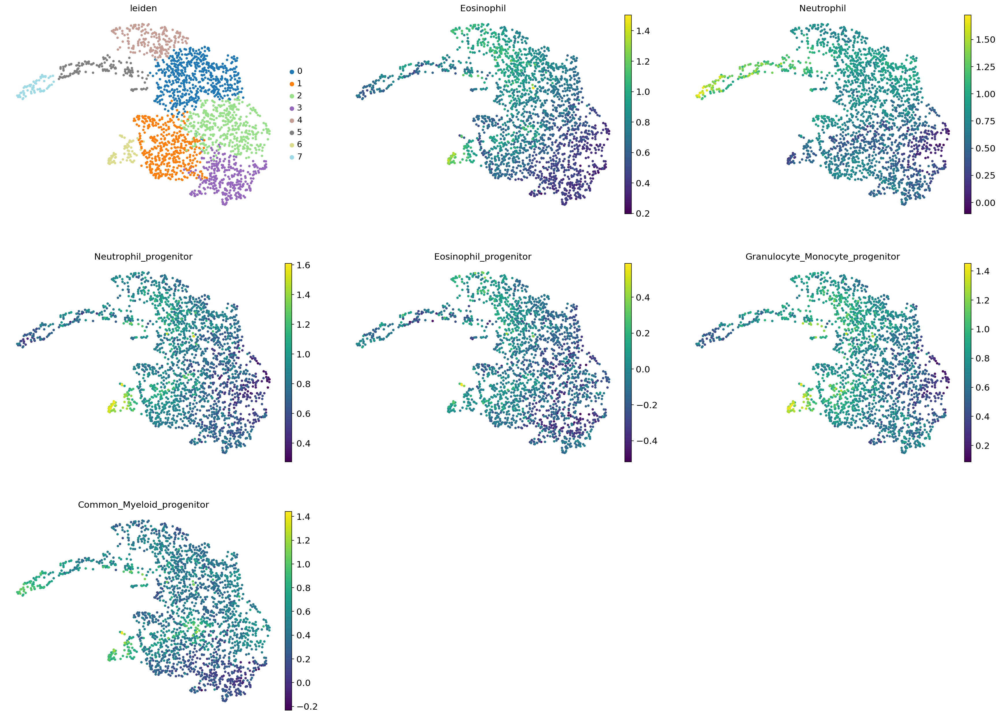

In [86]:
# hvg_HSC_v2.obs = hvg_HSC_v2.obs.join(HSC_modulescores_quantseq)
sc.set_figure_params(figsize = (8,6))
sc.pl.embedding(
    hvg_HSC_v2,
    basis = "umap", 
    color=[ "leiden", 'Eosinophil', 'Neutrophil', 'Neutrophil_progenitor',
       'Eosinophil_progenitor', 'Granulocyte_Monocyte_progenitor',
       'Common_Myeloid_progenitor'],
    frameon=False,
    ncols=3,
    save = "hvg_scVI_HSC_quantseq_modulescore_plots.pdf"
)

In [87]:
HSC_modulescores_table2 = pd.read_csv(out_dir + "../Rout/SA.hvg.HSC.table2.modulescores.csv", index_col = 0)

In [88]:
HSC_modulescores_table2.columns

Index(['basophil', 'EBM1', 'EBM2', 'eosinophil', 'monocyte',
       'multipotent_progenitor_1', 'multipotent_progenitor_2', 'neutrophil'],
      dtype='object')

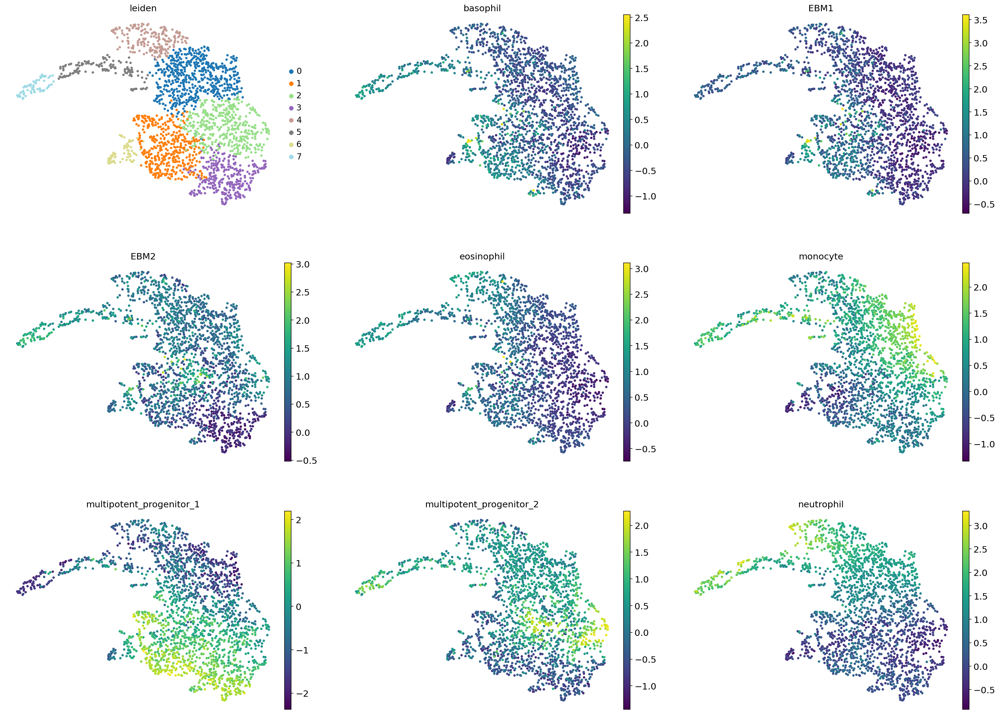

In [90]:
# hvg_HSC_v2.obs = hvg_HSC_v2.obs.join(HSC_modulescores_table2)
sc.set_figure_params(figsize = (8,6))
sc.pl.embedding(
    hvg_HSC_v2,
    basis = "umap", 
    color=[ "leiden",'basophil', 'EBM1', 'EBM2', 'eosinophil', 'monocyte',
       'multipotent_progenitor_1', 'multipotent_progenitor_2', 'neutrophil'],
    frameon=False,
    ncols=3,
    save = "hvg_scVI_HSC_table2_modulescore_plots.pdf"
)

In [91]:
HSC_modulescores_table5 = pd.read_csv(out_dir + "../Rout/SA.hvg.HSC.table5.modulescores.csv", index_col = 0)

In [92]:
HSC_modulescores_table5.columns

Index(['eos_stage1', 'eos_stage2', 'eos_stage3', 'eos_stage4', 'eos_stage5'], dtype='object')

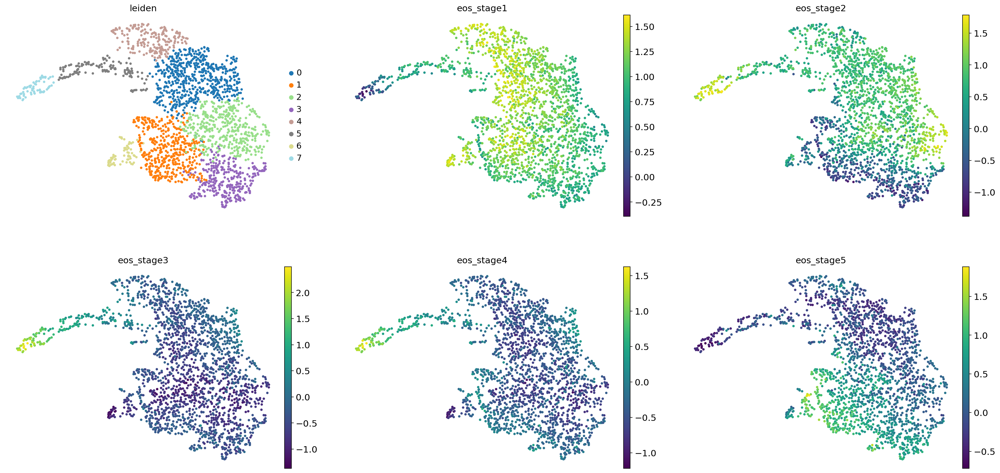

In [93]:
# hvg_HSC_v2.obs = hvg_HSC_v2.obs.join(HSC_modulescores_table5)
sc.set_figure_params(figsize = (8,6))
sc.pl.embedding(
    hvg_HSC_v2,
    basis = "umap", 
    color=[ "leiden",'eos_stage1', 'eos_stage2', 'eos_stage3', 'eos_stage4', 'eos_stage5'],
    frameon=False,
    ncols=3,
    save = "hvg_scVI_HSC_table5_modulescore_plots.pdf"
)

In [19]:
HSC_modulescores_panglodb = pd.read_csv(out_dir + "../Rout/SA.hvg.HSC.panglodb.modulescores.csv", index_col = 0)
HSC_modulescores_panglodb.columns

Index(['B_cells_memory', 'B_cells', 'Basophils', 'Dendritic_cells',
       'Erythroid-like_and_erythroid_precursor_cells', 'Gamma_delta_T_cells',
       'Macrophages', 'Mast_cells', 'Megakaryocytes', 'Monocytes',
       'Myeloid-derived_suppressor_cells', 'Natural_killer_T_cells',
       'Neutrophils', 'NK_cells', 'Nuocytes', 'Plasma_cells',
       'Plasmacytoid_dendritic_cells', 'Platelets', 'Red_pulp_macrophages',
       'Reticulocytes', 'T_regulatory_cells'],
      dtype='object')

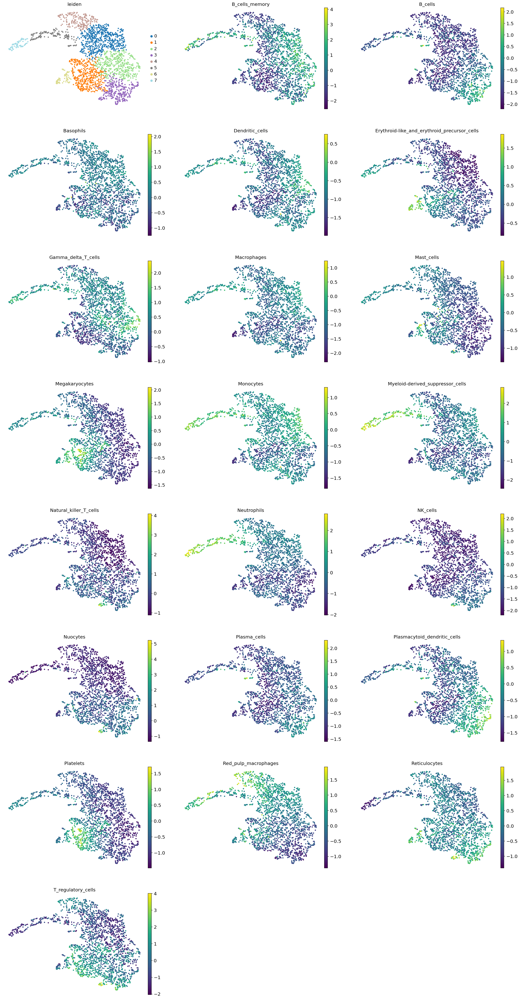

In [20]:
hvg_HSC_v2.obs = hvg_HSC_v2.obs.join(HSC_modulescores_panglodb)
sc.set_figure_params(figsize = (8,6))
sc.pl.embedding(
    hvg_HSC_v2,
    basis = "umap", 
    color=[ "leiden",'B_cells_memory', 'B_cells', 'Basophils', 'Dendritic_cells',
       'Erythroid-like_and_erythroid_precursor_cells', 'Gamma_delta_T_cells',
       'Macrophages', 'Mast_cells', 'Megakaryocytes', 'Monocytes',
       'Myeloid-derived_suppressor_cells', 'Natural_killer_T_cells',
       'Neutrophils', 'NK_cells', 'Nuocytes', 'Plasma_cells',
       'Plasmacytoid_dendritic_cells', 'Platelets', 'Red_pulp_macrophages',
       'Reticulocytes', 'T_regulatory_cells'],
    frameon=False,
    ncols=3,
    save = "hvg_scVI_HSC_panglodb_modulescore_plots.pdf"
)

### Mature annotations 

In [25]:
hvg_mature_v2 = hvg_subset[SA_exps_mature.obs_names.intersection(hvg_subset.obs_names)]
# SA_mature_v2 = SA_exps_mature[SA_exps_mature.obs_names.intersection(hvg_subset.obs_names)]

In [26]:
del hvg_mature_v2.obsm

In [27]:
hvg_mature_v2.layers

Layers with keys: counts, scVI_normalized

In [28]:
# sc.pp.normalize_total(hvg_mature_v2, target_sum=1e6)
# sc.pp.log1p(hvg_mature_v2)
sc.tl.pca(hvg_mature_v2, layer="scVI_normalized")
sc.pp.neighbors(hvg_mature_v2, use_rep="X_pca")
sc.tl.umap(hvg_mature_v2, random_state=46468856)
sc.tl.leiden(hvg_mature_v2, n_iterations=-1, resolution=0.5)

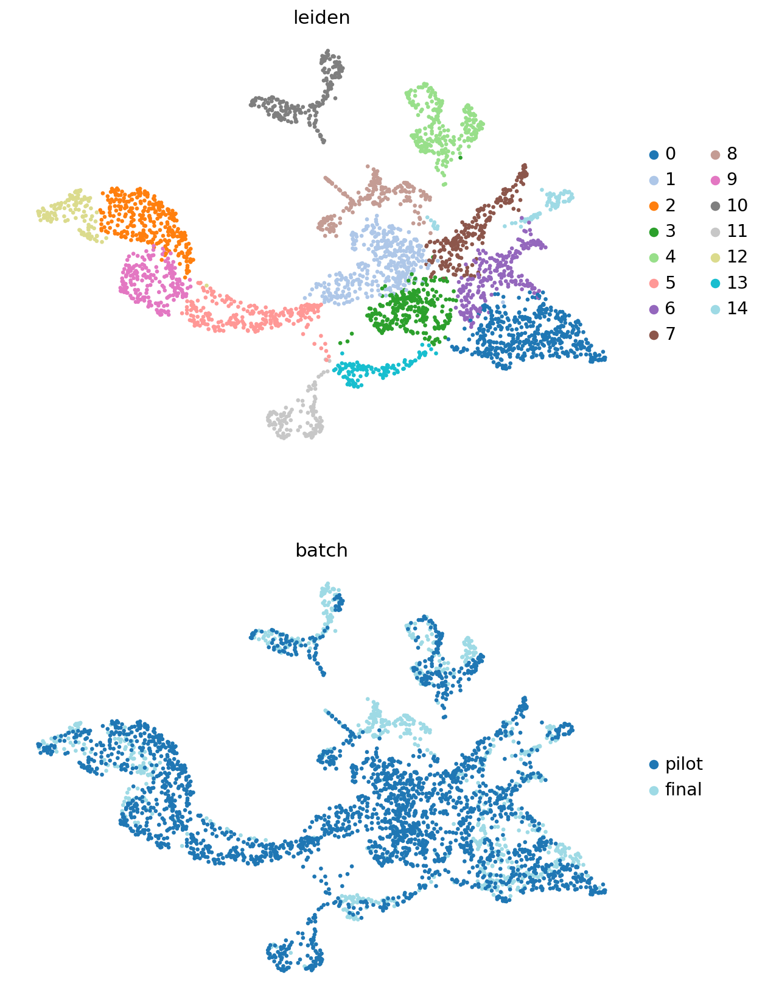

In [64]:
sc.set_figure_params(figsize = (8,6))
sc.pl.embedding(
    hvg_mature_v2,
    basis="umap",
    # color=['Mariem_annotation'],
    color=['leiden', 'batch'],
    frameon=False,
    ncols=1,
    palette = "tab20",
    save = "hvg_scVI_HSC_v2_leiden_manual_annotation_legend.pdf"
)

In [63]:
out_dir

'/home/anna/ClusterProjects/SA_bone_marrow/scfiles/'

In [55]:
# SA_mature_v2.write_loom(filename = out_dir + "SA_mature_v2.loom")
#hvg_mature_v2.write_loom(filename = out_dir + "hvg_mature_v2.loom")

The loom file will lack these fields:
{'_scvi_extra_continuous_covs', 'scVI_norm_pca', 'X_pca', 'X_scVI', '_scvi_extra_categorical_covs', 'PCs', 'counts_pca', 'X_umap', 'X_mde', 'X_tsne'}
Use write_obsm_varm=True to export multi-dimensional annotations


### Modulescoring mature cells

In [45]:
mature_modulescores_cytopus = pd.read_csv(out_dir + "../Rout/SA.hvg.mature.cytopus.modulescores.csv", index_col = 0)

In [46]:
mature_modulescores_cytopus.columns

Index(['abT', 'B-memory-DN', 'B-memory-IgM-MZ', 'B-memory-non-switched',
       'B-memory-switched', 'B-memory', 'B-naive', 'B-pb-mature', 'B-pb-t1',
       'B-pb-t2', 'B-pb-t3', 'B', 'capillary', 'CD4-T', 'CD56bright-NK',
       'CD56dim-NK', 'CD8-T_KLRG1neg-effector', 'CD8-T_KLRG1pos-effector',
       'CD8-T', 'cDC1', 'cDC2', 'cDC3', 'endo-aerocyte', 'endo-arterial',
       'endo-lymphatic', 'endo-systemic-venous', 'GC-B', 'gdT', 'gran', 'ILC1',
       'ILC2', 'ILC3-NCRneg', 'ILC3-NCRpos', 'Langerhans', 'Lti',
       'lung-endo-venous', 'Mac', 'mast', 'mo-DC', 'mono', 'NK-adaptive', 'NK',
       'p-DC', 'plasma-blast', 'plasma', 'T-naive', 'TCM', 'TEM', 'TFH',
       'Treg', 'TRM', 'TSCM'],
      dtype='object')

In [47]:
mature_modulescores_cytopus.columns

Index(['abT', 'B-memory-DN', 'B-memory-IgM-MZ', 'B-memory-non-switched',
       'B-memory-switched', 'B-memory', 'B-naive', 'B-pb-mature', 'B-pb-t1',
       'B-pb-t2', 'B-pb-t3', 'B', 'capillary', 'CD4-T', 'CD56bright-NK',
       'CD56dim-NK', 'CD8-T_KLRG1neg-effector', 'CD8-T_KLRG1pos-effector',
       'CD8-T', 'cDC1', 'cDC2', 'cDC3', 'endo-aerocyte', 'endo-arterial',
       'endo-lymphatic', 'endo-systemic-venous', 'GC-B', 'gdT', 'gran', 'ILC1',
       'ILC2', 'ILC3-NCRneg', 'ILC3-NCRpos', 'Langerhans', 'Lti',
       'lung-endo-venous', 'Mac', 'mast', 'mo-DC', 'mono', 'NK-adaptive', 'NK',
       'p-DC', 'plasma-blast', 'plasma', 'T-naive', 'TCM', 'TEM', 'TFH',
       'Treg', 'TRM', 'TSCM'],
      dtype='object')

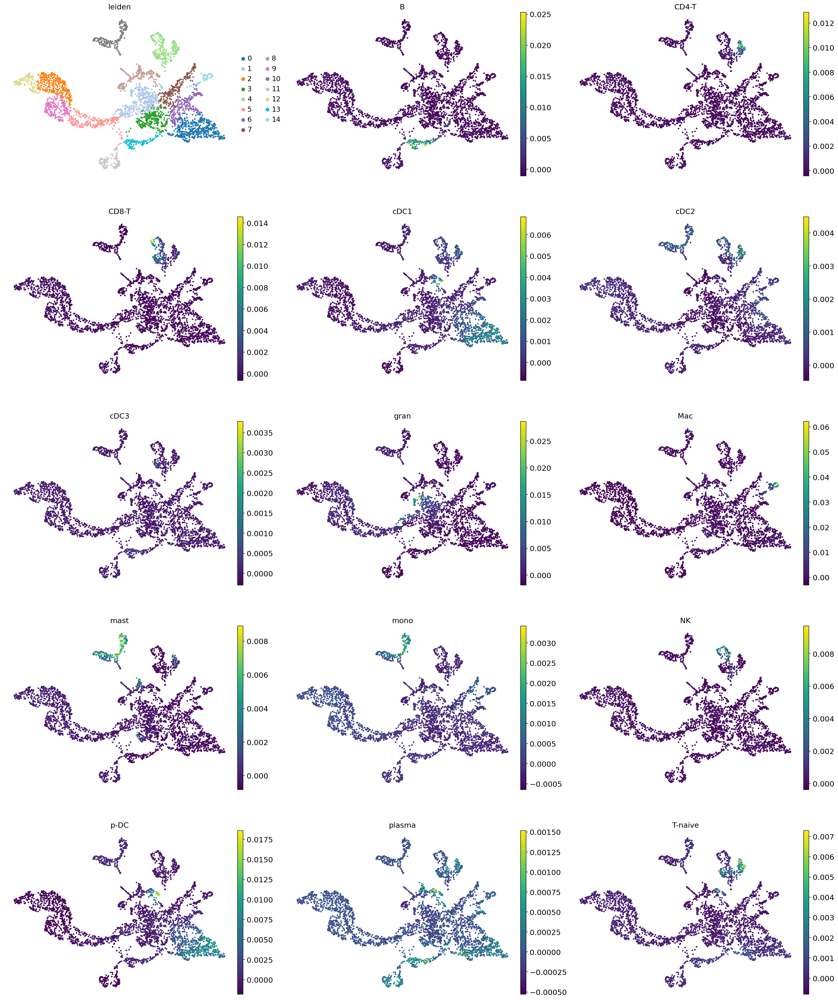

In [51]:
hvg_mature_v2.obs = hvg_mature_v2.obs.join( mature_modulescores_cytopus)
sc.set_figure_params(figsize = (8,6))
sc.pl.embedding(
    hvg_mature_v2,
    basis = "umap", 
    color=[ "leiden", "B", "CD4-T", "CD8-T", 'cDC1', 'cDC2', 'cDC3',
          'gran', 'Mac', 'mast', 'mono', 'NK','p-DC', 
           'plasma', 'T-naive'],
    frameon=False,
    ncols=3,
    save = "hvg_scVI_mature_cytopus_modulescore_plots.pdf"
)

In [52]:
mature_modulescores_quantseq = pd.read_csv(out_dir + "../Rout/SA.hvg.mature.Quantseq.modulescores.csv", index_col = 0)
mature_modulescores_quantseq
print(mature_modulescores_quantseq.columns)

Index(['Eosinophil', 'Neutrophil', 'Neutrophil_progenitor',
       'Eosinophil_progenitor', 'Granulocyte_Monocyte_progenitor',
       'Common_Myeloid_progenitor'],
      dtype='object')


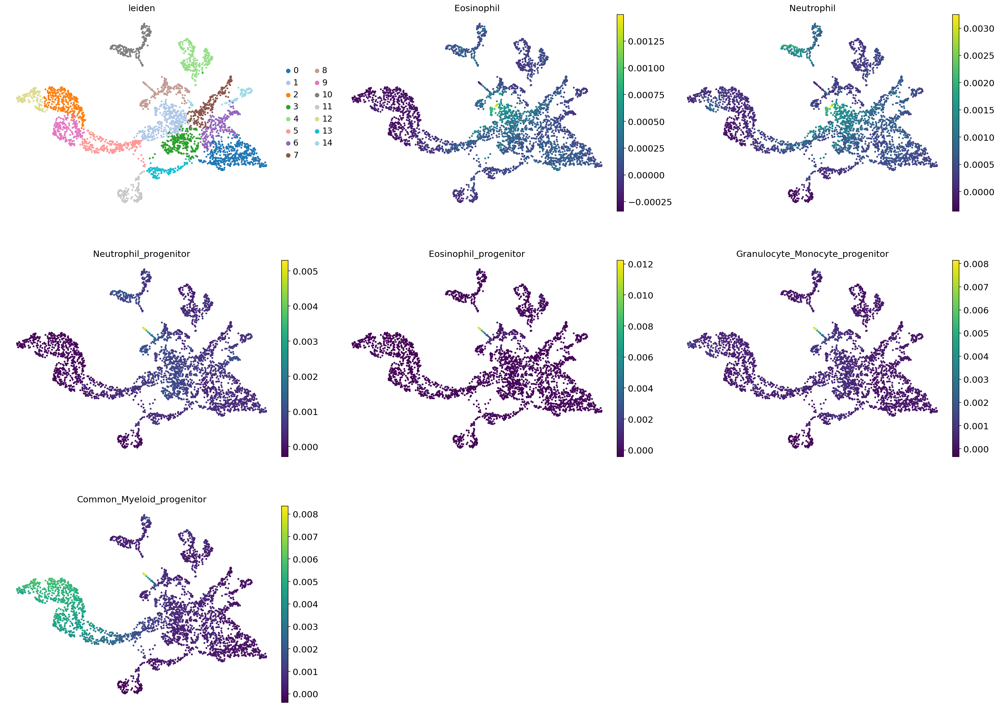

In [53]:
hvg_mature_v2.obs = hvg_mature_v2.obs.join( mature_modulescores_quantseq)
sc.set_figure_params(figsize = (8,6))
sc.pl.embedding(
    hvg_mature_v2,
    basis = "umap", 
    color=[ "leiden", 'Eosinophil', 'Neutrophil', 'Neutrophil_progenitor',
       'Eosinophil_progenitor', 'Granulocyte_Monocyte_progenitor',
       'Common_Myeloid_progenitor'],
    frameon=False,
    ncols=3,
    save = "hvg_scVI_mature_Quantseq_modulescore_plots.pdf"
)

In [55]:
mature_modulescores_table2 = pd.read_csv(out_dir + "../Rout/SA.mature.table2.modulescores.csv", index_col = 0)
mature_modulescores_table2
print(mature_modulescores_table2.columns)

Index(['basophil', 'EBM1', 'EBM2', 'eosinophil', 'monocyte',
       'multipotent_progenitor_1', 'multipotent_progenitor_2', 'neutrophil'],
      dtype='object')


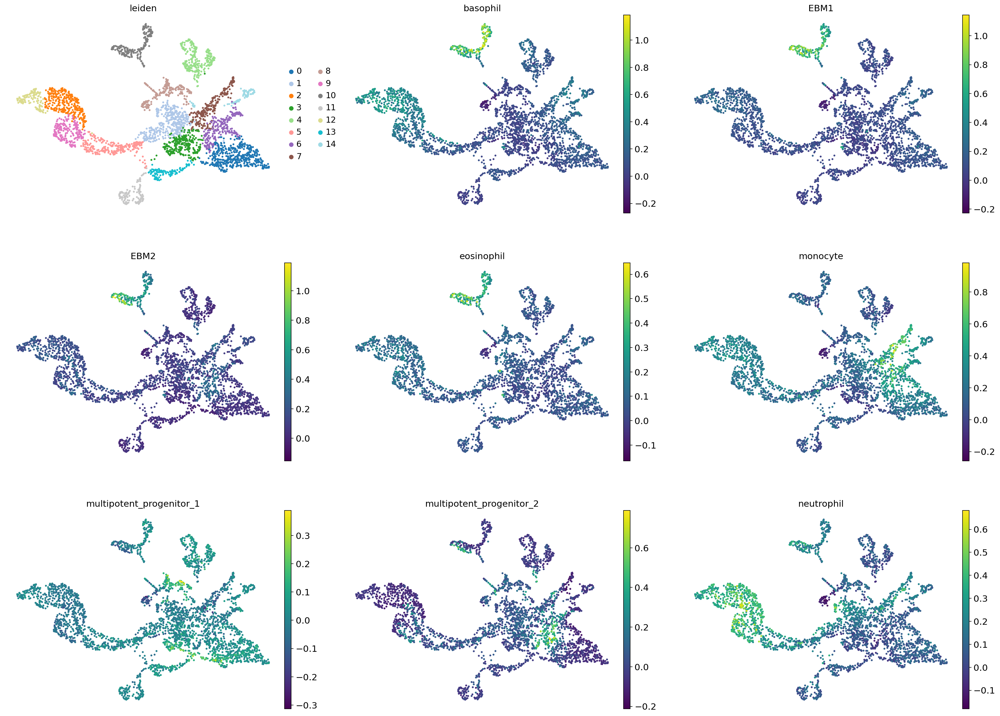

In [56]:
hvg_mature_v2.obs = hvg_mature_v2.obs.join( mature_modulescores_table2)
sc.set_figure_params(figsize = (8,6))
sc.pl.embedding(
    hvg_mature_v2,
    basis = "umap", 
    color=[ "leiden", 'basophil', 'EBM1', 'EBM2', 'eosinophil', 'monocyte',
       'multipotent_progenitor_1', 'multipotent_progenitor_2', 'neutrophil'],
    frameon=False,
    ncols=3,
    save = "hvg_scVI_mature_table2_modulescore_plots.pdf"
)

In [58]:
mature_modulescores_table5 = pd.read_csv(out_dir + "../Rout/SA.mature.table5.modulescores.csv", index_col = 0)
mature_modulescores_table5
print(mature_modulescores_table5.columns)

Index(['eos_stage1', 'eos_stage2', 'eos_stage3', 'eos_stage4', 'eos_stage5'], dtype='object')


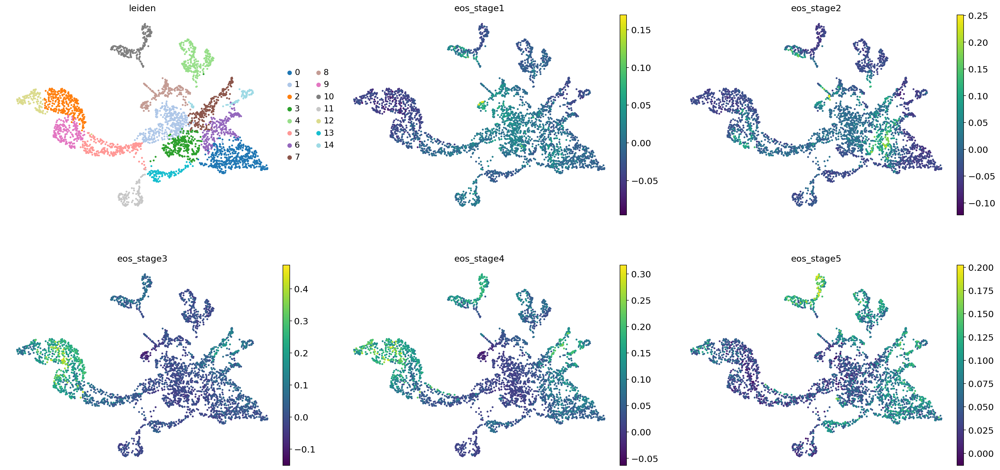

In [59]:
hvg_mature_v2.obs = hvg_mature_v2.obs.join( mature_modulescores_table5)
sc.set_figure_params(figsize = (8,6))
sc.pl.embedding(
    hvg_mature_v2,
    basis = "umap", 
    color=[ "leiden", 'eos_stage1', 'eos_stage2', 'eos_stage3', 'eos_stage4', 'eos_stage5'],
    frameon=False,
    ncols=3,
    save = "hvg_scVI_mature_table5_modulescore_plots.pdf"
)

In [60]:
hvg_mature_v2.obs.columns

Index(['nCount_RNA', 'nFeature_RNA', 'sample', 'nCount_HTO', 'nFeature_HTO',
       'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification',
       'hash.ID', 'RNA_snn_res.0.6', 'seurat_clusters', 'percent_mt',
       'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'rnaseq_labels',
       'immgen_labels', 'batch', '_scvi_batch', '_scvi_labels', 'leiden',
       'scNym_condensed', 'scNym_condensed_confidence', 'abT', 'B-memory-DN',
       'B-memory-IgM-MZ', 'B-memory-non-switched', 'B-memory-switched',
       'B-memory', 'B-naive', 'B-pb-mature', 'B-pb-t1', 'B-pb-t2', 'B-pb-t3',
       'B', 'capillary', 'CD4-T', 'CD56bright-NK', 'CD56dim-NK',
       'CD8-T_KLRG1neg-effector', 'CD8-T_KLRG1pos-effector', 'CD8-T', 'cDC1',
       'cDC2', 'cDC3', 'endo-aerocyte', 'endo-arterial', 'endo-lymphatic',
       'endo-systemic-venous', 'GC-B', 'gdT', 'gran', 'ILC1', 'ILC2',
       'ILC3-NCRneg', 'ILC3-NCRpos', 'Langerhans', 'Lti', 'lung-endo-venous',
       'Mac', 'mast', 'mo-DC', 'mono', '

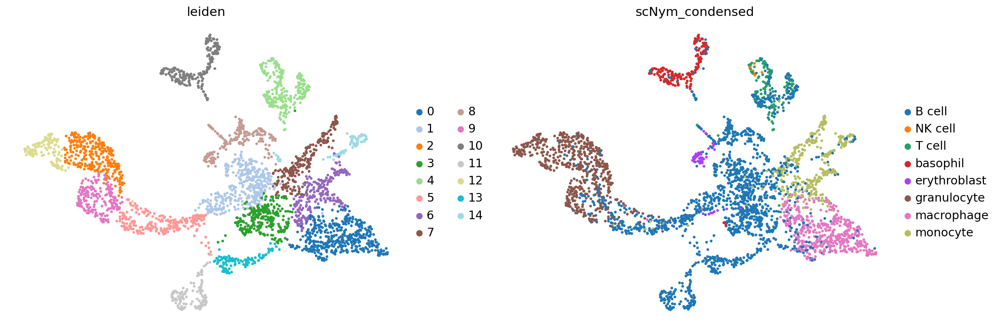

In [62]:
sc.set_figure_params(figsize = (8,6))
sc.pl.embedding(
    hvg_mature_v2,
    basis = "umap", 
    color=[ "leiden", "scNym_condensed"],
    frameon=False,
    ncols=3,
    save = "hvg_scVI_mature_scNym_annotation.pdf"
)

In [23]:
mature_modulescores_panglodb = pd.read_csv(out_dir + "../Rout/SA.hvg.mature.panglodb.modulescores.csv", index_col = 0)
mature_modulescores_panglodb.columns

Index(['B_cells_memory', 'B_cells', 'Basophils', 'Dendritic_cells',
       'Erythroid-like_and_erythroid_precursor_cells', 'Gamma_delta_T_cells',
       'Macrophages', 'Mast_cells', 'Megakaryocytes', 'Monocytes',
       'Myeloid-derived_suppressor_cells', 'Natural_killer_T_cells',
       'Neutrophils', 'NK_cells', 'Nuocytes', 'Plasma_cells',
       'Plasmacytoid_dendritic_cells', 'Platelets', 'Red_pulp_macrophages',
       'Reticulocytes', 'T_regulatory_cells'],
      dtype='object')

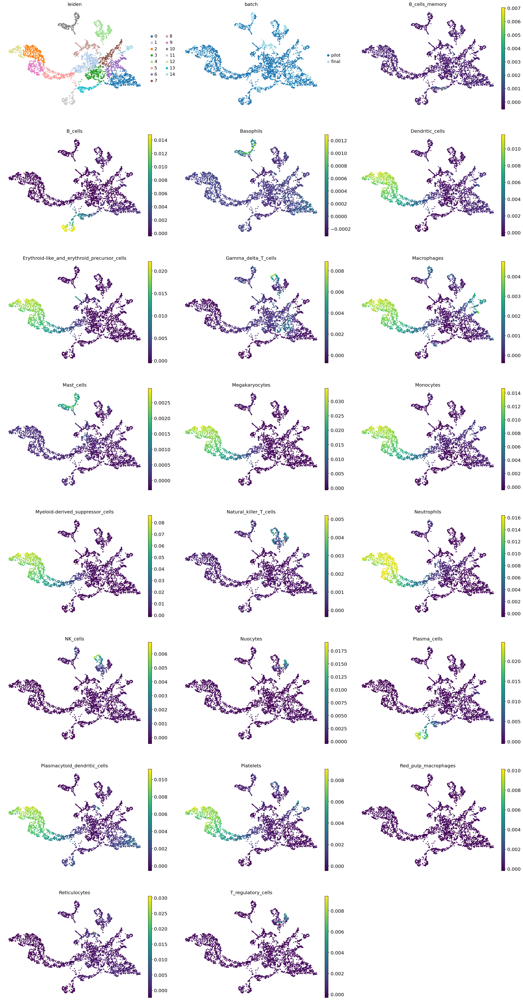

In [34]:
hvg_mature_v2.obs = hvg_mature_v2.obs.join(mature_modulescores_panglodb)
sc.set_figure_params(figsize = (8,6))
sc.pl.embedding(
    hvg_mature_v2,
    basis = "umap", 
    color=[ "leiden", "batch", 'B_cells_memory', 'B_cells', 'Basophils', 'Dendritic_cells',
       'Erythroid-like_and_erythroid_precursor_cells', 'Gamma_delta_T_cells',
       'Macrophages', 'Mast_cells', 'Megakaryocytes', 'Monocytes',
       'Myeloid-derived_suppressor_cells', 'Natural_killer_T_cells',
       'Neutrophils', 'NK_cells', 'Nuocytes', 'Plasma_cells',
       'Plasmacytoid_dendritic_cells', 'Platelets', 'Red_pulp_macrophages',
       'Reticulocytes', 'T_regulatory_cells'],
    frameon=False,
    ncols=3,
    save = "hvg_scVI_mature_panglodb_modulescore_plots.pdf"
)